---

---


# 🚧 **PROJECT FINAL** - Optimizing Sports Performance : Activity Recognition 🏋🏻‍♂️ 📲
##### **Eugenia MELLANO** & **Doriane DOYON-DOUSSE** : *Certification bloc 6* ✅  (**ds_fs_od_03** 📖)

---

## 🟢 <ins>**INTRODUCTION : What is the study subject ?**</ins>

### 🔸**Activity Recognition - Accelerometer** 📲 🔍
An accelerometer is a type of sensor used to **measure linear acceleration in three dimensions of space**. This device can detect changes in motion velocity in all three directions of the three-dimensional space.

* Here the **user** variable is a person wearing a *phone on the front pocket of the pant*. : **phones have integrated accelerometers** that were used during this experiment to **label the type of activity**
<br>

* As mentionned before, accelerometer is collecting 3 axial plan informations
  * <ins>**X-Axis:**</ins> Represents acceleration in the horizontal direction, usually from **left to right or vice versa**.

  * <ins>**Y-Axis:**</ins> Represents acceleration in the vertical direction, typically from **bottom to top or vice versa**.

  * <ins>**Z-Axis:**</ins> Represents acceleration in the axial direction, meaning **towards/forward** from the center of the device.

Accelerometers operate based on **physical principles**. When an accelerated object experiences a *change in velocity*, the accelerometer detects this change by **measuring the resulting force exerted on a component sensitive to acceleration**.

---

## 🟢 <ins>**Data loading & lecture**</ins>

### ▪️ **Librairies importations** 📚
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [1]:
# Importation of data manipulation libraries
# ----------------------------------------------------------------------
import pandas as pd
import numpy as np
import datetime
from datetime import timedelta
from scipy import stats
from scipy.signal import find_peaks
from statsmodels.tsa.seasonal import seasonal_decompose
import warnings
warnings.filterwarnings('ignore')

# Importation visualizations libraries
# ----------------------------------------------------------------------
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px


# Importation of Machine Learning sklearn librairy
# ----------------------------------------------------------------------
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import f1_score

# Importation of Deep Learning keras library
# ----------------------------------------------------------------------
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Flatten
from keras.layers import Dropout
from keras.layers import LSTM
from tensorflow.keras.callbacks import EarlyStopping

### ▪️ **Connecting to Google Drive** 🛜
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

### ▪️ **Lecture of the Dataset** 💿
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [2]:
# Lecture of the dataset from google drive path
# ----------------------------------------------------------------------

print('-------------- Loading and reading the dataset... --------------')
print()
import gdown
url = 'https://drive.google.com/uc?id=1NaWDp5bGI4kT_tIJ2gkraOmhh0YP-YUd'
output = 'data.csv'
gdown.download(url, output, quiet=False)
df_acc = pd.read_csv(output)
print()
print('--------------             ...Done               ---------------')

-------------- Loading and reading the dataset... --------------



Downloading...
From: https://drive.google.com/uc?id=1NaWDp5bGI4kT_tIJ2gkraOmhh0YP-YUd
To: /content/data.csv
100%|██████████| 48.5M/48.5M [00:00<00:00, 96.1MB/s]



--------------             ...Done               ---------------


----


## 🟢 <ins>**Exploratory Data Analysis** (EDA)</ins> 📈

### ▪️ **Collecting basic informations asbout the dataset** 👀
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [ ]:
print('*************************************************************************************************************')
print('------------------    A C C E L E R O M E T E R   D A T A S E T   B A S I C   I N F O S.   ------------------')
print('*************************************************************************************************************')
print()
print() # Please check scrollable element to see full results
print()

print("********** The shape of the Accelerometer Dataset : **********")
print()
print(f'The Tinder dataset is composed of {df_acc.shape[0]} rows and {df_acc.shape[1]} columns.')
print()
print('-------------------------------------------------------------------------------------------------------------')
print()

print("********** Let's have a first look at the dataset visualizing the first 5 rows : **********")
print()
display(df_acc.head())
print()
print('-------------------------------------------------------------------------------------------------------------')
print()

print('********** Here are some basic statistics about the dataset : **********')
print()
display(df_acc.describe(include='all'))
print()
print('-------------------------------------------------------------------------------------------------------------')
print()

print(' ********** % Percentage of missing values : **********')
print()
print(round(df_acc.isnull().sum()*100/len(df_acc), 2))
print()
print('-------------------------------------------------------------------------------------------------------------')
print()

print('********** Listing the column names : **********')
print()
print([col for col in df_acc.columns])
print()
print('-------------------------------------------------------------------------------------------------------------')
print()

print('********** Data types of columns from the dataset : **********')
print()
print(df_acc.dtypes)
print()
print('-------------------------------------------------------------------------------------------------------------')
print()

print('********** Checking for more information : **********')
print()
print(df_acc.info())
print()
print('-------------------------------------------------------------------------------------------------------------')
print()

print('********** Checking for Duplicates : **********')
print()
duplicates = df_acc.duplicated().sum()
print(f'The Accelerometer dataset contains {duplicates} duplicates')

print()
print()
print('*************************************************************************************************************')
print('*************************************************************************************************************')

*************************************************************************************************************
------------------    A C C E L E R O M E T E R   D A T A S E T   B A S I C   I N F O S.   ------------------
*************************************************************************************************************



********** The shape of the Accelerometer Dataset : **********

The Tinder dataset is composed of 1073623 rows and 6 columns.

-------------------------------------------------------------------------------------------------------------

********** Let's have a first look at the dataset visualizing the first 5 rows : **********



,user,activity,timestamp,x-axis,y-axis,z-axis
0,1,Walking,4991922345000,0.69,10.80,-2.03
1,1,Walking,4991972333000,6.85,7.44,-0.50
2,1,Walking,4992022351000,0.93,5.63,-0.50
3,1,Walking,4992072339000,-2.11,5.01,-0.69
4,1,Walking,4992122358000,-4.59,4.29,-1.95



-------------------------------------------------------------------------------------------------------------

********** Here are some basic statistics about the dataset : **********



,user,activity,timestamp,x-axis,y-axis,z-axis
count,1.073623e+06,1073623,1.073623e+06,1.073623e+06,1.073623e+06,1.073623e+06
unique,NaN,6,NaN,NaN,NaN,NaN
top,NaN,Walking,NaN,NaN,NaN,NaN
freq,NaN,417901,NaN,NaN,NaN,NaN
mean,1.880682e+01,NaN,3.289157e+13,6.720567e-01,7.332700e+00,4.024567e-01
std,1.028704e+01,NaN,4.909825e+13,6.916894e+00,6.732950e+00,4.789301e+00
min,1.000000e+00,NaN,7.345234e+10,-1.961000e+01,-1.961000e+01,-1.980000e+01
25%,1.000000e+01,NaN,2.057092e+12,-2.960000e+00,3.340000e+00,-2.260978e+00
50%,1.900000e+01,NaN,9.750603e+12,3.400000e-01,8.010000e+00,-4.000000e-02
75%,2.800000e+01,NaN,3.525530e+13,4.520000e+00,1.160000e+01,2.760000e+00



-------------------------------------------------------------------------------------------------------------

 ********** % Percentage of missing values : **********

user         0.0
activity     0.0
timestamp    0.0
x-axis       0.0
y-axis       0.0
z-axis       0.0
dtype: float64

-------------------------------------------------------------------------------------------------------------

********** Listing the column names : **********

['user', 'activity', 'timestamp', 'x-axis', 'y-axis', 'z-axis']

-------------------------------------------------------------------------------------------------------------

********** Data types of columns from the dataset : **********

user           int64
activity      object
timestamp      int64
x-axis       float64
y-axis       float64
z-axis       float64
dtype: object

-------------------------------------------------------------------------------------------------------------

********** Checking for more information : **********

<clas

---

### 🔸**Observation à partir des infos extraites** 🔍

* **Pas de valeurs manquantes** 😁
* Activité la plus fréquente : la marche
* Dataset volumineux :
  * **1 million** de lignes *1073623*
  * Peu de colonnes : 6 en tout
  * **49.1+ MB** de memoire
* Datatype de la variable "activité à modifier : de objet à string
* 53788 duplicates lié aux données opitionnelles (x, y et z) qui peuvent etre similaires entre différents utilisateurs bien qu'indépendantes
<br>

* Nous sommes face à un problème de **classification multiclasse**
  * **Varaible cible (target) : 'activity'**
    * Qui peut prendre **6 classes** (marche, monter escalier, descendre escalier, jogging, assis, debout) --> c'est ce que l'on souhaite prédire
  * Features qui vont permettre la prediction de la target :
    * 'X axis'
    * 'Y axis'
    * 'Z axis'
    * 'Timestamps'


---

### ▪️ **Counting activities** 🏋🏻‍♂️
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph Matplotlib** 🔺

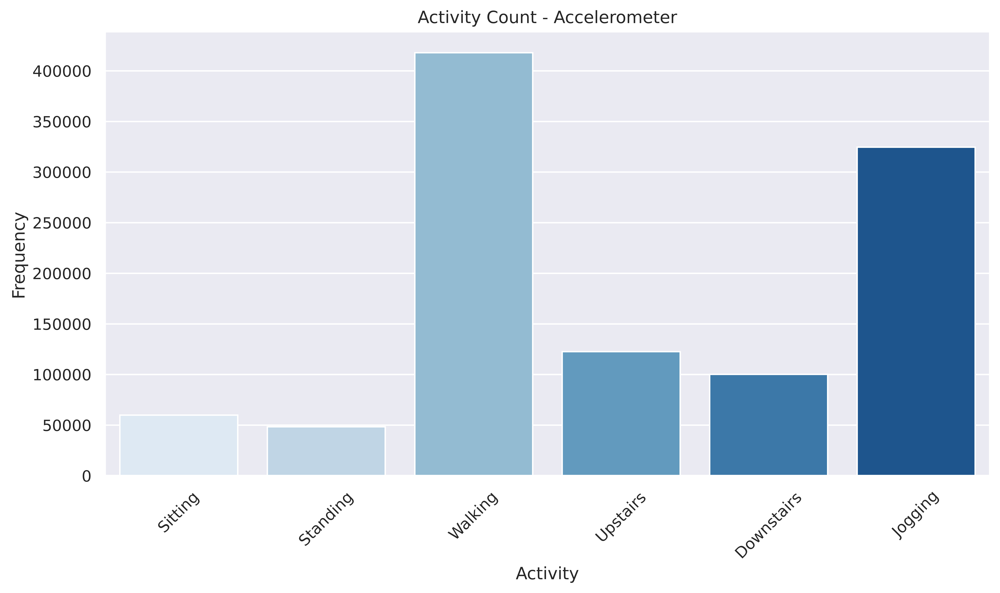

In [ ]:
# Graph of acitivity frequency with matplotlib
# ----------------------------------------------------------------------------------------

fig, ax = plt.subplots(figsize=(10, 6)) # Creating the graph and axis, and size figure

activity_counts = df_acc['activity'].value_counts() # Counting activities with value_counts() method

activity_order = ['Sitting', 'Standing', 'Walking', 'Upstairs', 'Downstairs', 'Jogging'] # Order of activities

sns.barplot(x=activity_counts.index, y=activity_counts.values, # seaborn graph of ordered activity count
            ax=ax, order=activity_order, palette='Blues')

ax.set_title('Activity Count - Accelerometer') # Setting global title
ax.set_xlabel('Activity') # Setting x axis subtitle
ax.set_ylabel('Frequency') # Setting y axis subtitle

plt.xticks(rotation=45) # Rotation of x labels for better readability

plt.tight_layout() # Showing the graph
plt.show()

### 📣 **Due to the high volume of rows (1 million) it is very hard to compute this udge amount of data. We sample the data and split it in 2 : 500000 or 200000 rows (depending on the type of graph) in order to make possible the visualisations : we called it 'df_sample'** 📣

In [ ]:
# Taking a sample of df_acc
# ---------------------------------------------------------------------------
df_sample = df_acc.sample(200000)

### ▪️ **Counting activities : with ordered values** 🏋🏻‍♂️
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph Plotly** 🔺

In [ ]:
# Graph of acitivity frequency with matplotlib
# ---------------------------------------------------------------------------
import plotly.express as px # importations of plotly librairies
import plotly.graph_objects as go
import plotly.io as pio

pio.templates["doriane"] = go.layout.Template( # building a color template)
    layout_colorway=[
        "#f3cec9",
        "#4B9AC7",
        "#4BE8E0",
        "#9DD4F3",
        "#97FBF6",
        "#2A7FAF",
        "#23B1AB",
        "#0E3449",
        "#015955",])

pio.templates.default = "doriane"

# Graph with diffrent colors for each activities
fig = px.bar(df_sample, x='activity', color='activity')
# Setting title and figsize
fig.update_layout(title="Activity Count - Accelerometer",
                  autosize=False, width=900, height=700)
fig.update_xaxes(categoryorder='array',
                 categoryarray= ['Walking', 'Jogging', 'Upstairs',
                                 'Downstairs', 'Sitting', 'Standing'])
fig.show('colab') # after ordering values, show the graph

### ▪️ **How many data examples (timestamps) were collected for each user.** 👩🏽‍💻
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph Seaborn** 🔺

<Axes: title={'center': 'Number of timestamps collected per User'}, xlabel='user', ylabel='count'>

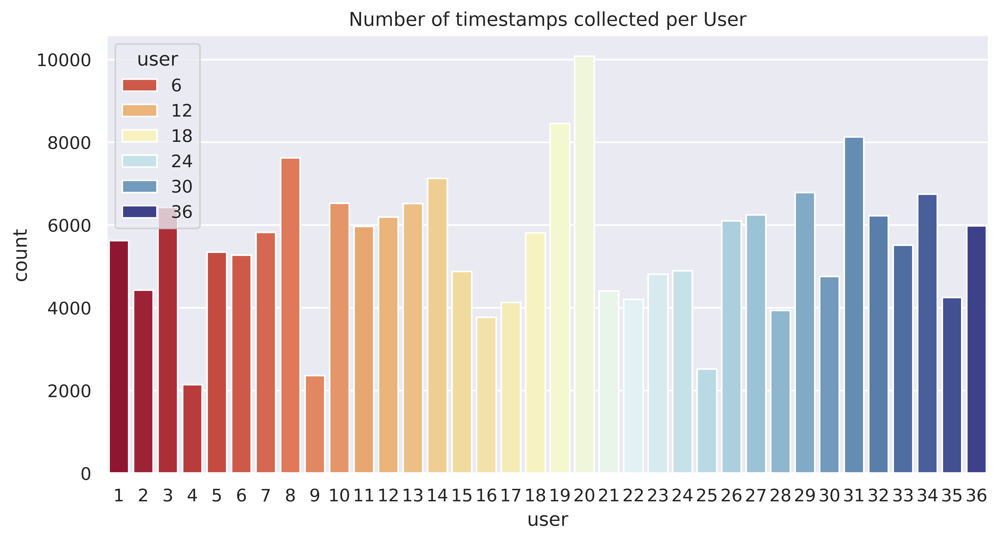

In [ ]:
# Graph of acitivity frequency with seaborn
# ----------------------------------------------------------------

# Setting size of figure and theme
plt.figure(figsize=(10, 5))
sns.set_theme(rc={'figure.dpi': 600})

# Setting the title name and its size
plt.title('Number of timestamps collected per User', fontsize=12)

# Plotting with seaborn the count for each users
sns.countplot(df_sample, x='user', hue='user', palette='RdYlBu')

### ▪️ **Frequency of activities per users** 🙋🏼‍♀️🙋🏽‍♂️
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

##### 👋🏼We made another one *to see better the proportions of each activites per users*.

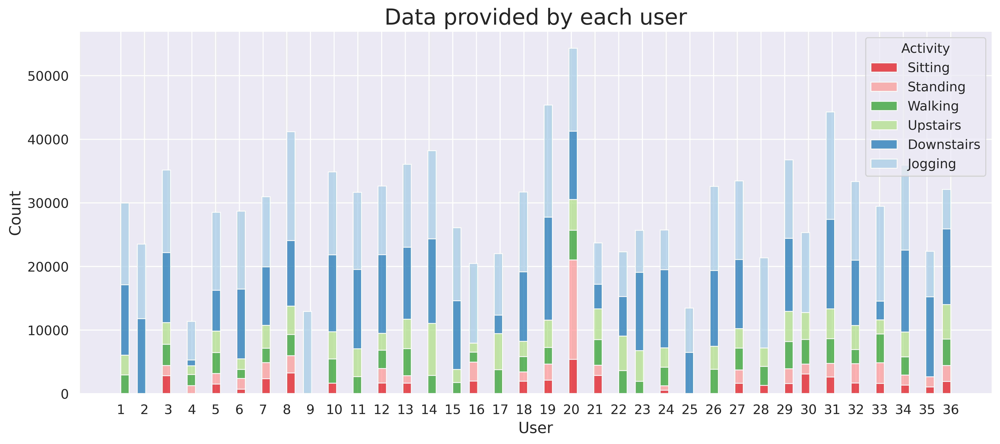

In [ ]:
# Graph activity frequency per users seaborn : proportions showed with stacked plot
# -------------------------------------------------------------------------------------
# Counting frequencies of each activity for each user
activity_counts = df_acc.groupby(['user', 'activity']).size().unstack(fill_value=0)
activity_counts = activity_counts[activity_order]

plt.figure(figsize=(15, 6))
plt.title('Data provided by each user', fontsize=20)
sns.set_style("white")
sns.set_theme(rc={'figure.dpi': 600})
sns.histplot(data=df_acc, x='user', hue='activity', multiple='stack', palette='Paired')

# Manually create a legend based on actity order
legend_labels = activity_order
plt.legend(legend_labels, title='Activity', fontsize=12)

# Setting titles and showing graph
plt.xlabel('User', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(ticks=df_acc['user'].unique(), fontsize=12)
plt.yticks(fontsize=12)

plt.show()

##### 👋🏼 Almost **all users performed 6 different activities**. Let's take a closer look at the **behavior over a timeline** of some user

### ▪️ **Activities of users over time** ⏰
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph with matplotlib** 🔺

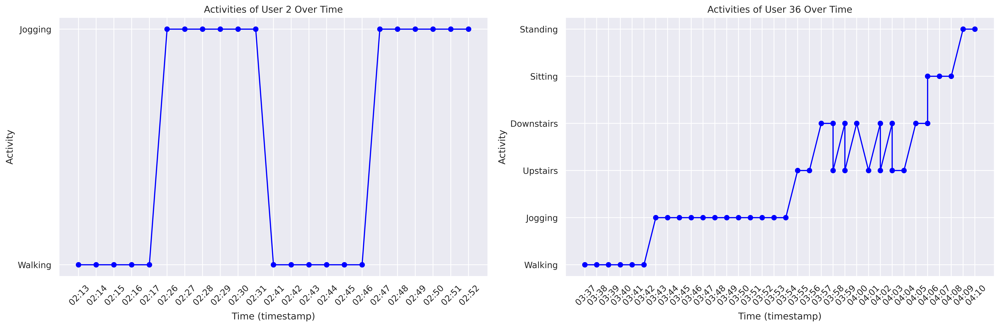

In [ ]:
# Timestamps per user : taking the example of user number 2 and user number 36
# ----------------------------------------------------------------------------------------------------------
df_acc['timestamp_str'] = df_acc['timestamp'].apply(lambda x: timedelta(microseconds=round(x, -3) // 1000))
# Filter data for user 2 and user 36
user_2_data = df_acc[df_acc['user'] == 2]
user_36_data = df_acc[df_acc['user'] == 36]
#user_2_data['timestamp_hour'] = user_2_data['timestamp_str'].apply(lambda x: str(x)[6:12])
#user_36_data['timestamp_hour'] = user_36_data['timestamp_str'].apply(lambda x: str(x)[6:12])
user_2_data.loc[:, 'timestamp_hour'] = user_2_data['timestamp_str'].apply(lambda x: str(x)[6:12])
user_36_data.loc[:, 'timestamp_hour'] = user_36_data['timestamp_str'].apply(lambda x: str(x)[6:12])

user_2_data_grouped = user_2_data.groupby(['timestamp_hour', 'activity']).size().reset_index(name='count')
user_36_data_grouped = user_36_data.groupby(['timestamp_hour', 'activity']).size().reset_index(name='count')


# Set up the figure with two subplots
fig, axs = plt.subplots(1, 2, figsize=(18, 6))

# Plot the activities of user 2
axs[0].plot(user_2_data_grouped['timestamp_hour'], user_2_data_grouped['activity'], marker='o', color='blue')
axs[0].set_xlabel('Time (timestamp)')
axs[0].set_ylabel('Activity')
axs[0].set_title('Activities of User 2 Over Time')
axs[0].tick_params(axis='x', labelrotation=45)
axs[0].grid(True)

# Plot the activities of user 36
axs[1].plot(user_36_data_grouped['timestamp_hour'], user_36_data_grouped['activity'], marker='o', color='blue')
axs[1].set_xlabel('Time (timestamp)')
axs[1].set_ylabel('Activity')
axs[1].set_title('Activities of User 36 Over Time')
axs[1].tick_params(axis='x', labelrotation=45)
axs[1].grid(True)

# Adjust layout
plt.tight_layout()

# Display the plot
plt.show()

### ▪️ **Representation of activities in 3D for one user** 👀
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph with plotly** 🔺

In [ ]:
# Let's represent in 3D all axis in relation with activities (example of user number 36)
# -----------------------------------------------------------------------------------------

df_user36 = df_acc[df_acc['user'] == 36] # we select on user going through all activities

activity_colors = {'Walking': 'red',   # Defining a unique color for each activities
                   'Jogging': 'blue',
                   'Upstairs': 'green',
                   'Standing': 'orange',
                   'Upstair': 'purple',
                   'Sitting': 'yellow'}

fig = px.scatter_3d(df_user36, x='x-axis', y='y-axis', z='z-axis', # 3D graph with plotly
                    color='activity', color_discrete_map=activity_colors,
                    title='Activities in 3D Space - User 36')

fig.update_traces(marker=dict(size=4)) # Reducing size of points for better visualization

fig.update_traces(opacity=0.5) # Ajust opacity of points
fig.update_layout(legend=dict(font=dict(size=16)))

fig.show() # Show the interactive graph

### ▪️ **Representation of 2 activities in 3D for 2 users** 👀
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph with plotly** 🔺

In [ ]:
# Let's represent in 3D all axis in relation with 2 activities (Jogging/Sitting) for 2 users
# ----------------------------------------------------------------------------------------------

# Filtering selected activities and users
df_filtered = df_acc[((df_acc['user'] == 8) | (df_acc['user'] == 36)) &
                     ((df_acc['activity'] == 'Sitting') | (df_acc['activity'] == 'Jogging'))]

# We create a column to filter activities
df_filtered['user_activity'] = df_filtered['user'].astype(str) + ':' + df_filtered['activity']

# We set different colors associted with activities
colors = {'1:Sitting': 'red', '1:Jogging': 'blue', '2:Sitting': 'green', '2:Jogging': 'orange'}

fig = px.scatter_3d(df_filtered, x='x-axis', y='y-axis', z='z-axis', color='user_activity',
                    color_discrete_map=colors, title='Activities in 3D Space') # 3D plot

fig.update_traces(marker=dict(size=4)) # Reducing size of points for better visualization
fig.update_traces(opacity=0.5)  # Ajust opacity of points
fig.update_layout(legend=dict(font=dict(size=16))) # Ajust legend

fig.show() # Show the interactive graph



### ▪️ **Representation of activities for each axis**📈
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph with matplotlib/seaborn** 🔺

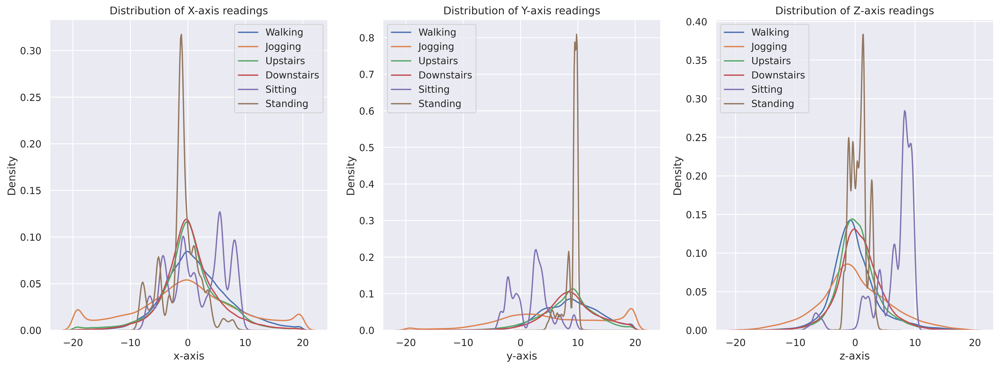

In [ ]:
# Let's represent in 3D all axis in relation with 2 activities (Jogging/Sitting) for 2 users
# ----------------------------------------------------------------------------------------------
x_acc_cols = ['x-axis']
y_acc_cols = ['y-axis'] # List of columns representing X, Y and Z axis
z_acc_cols = ['z-axis']

axis_labels = ['X', 'Y', 'Z'] # Naming the axis

fig, axes = plt.subplots(1, 3, figsize=(16, 6)) # Creation of subgraphs
axes = axes.flatten()

# For each axis we generate a plot in relation with activities (for loop)
for label, cols, ax in zip(axis_labels, [x_acc_cols, y_acc_cols, z_acc_cols], axes):
    for activity in df_acc['activity'].unique(): # Kernel density for each activities (per axis)
        sns.kdeplot(data=df_acc[df_acc['activity'] == activity][cols[0]], ax=ax, label=activity)

    ax.set_title(f'Distribution of {label}-axis readings') # Setting the title
    ax.legend() # Aggregating legend

plt.tight_layout()
plt.show() # Display of graphs

👋🏼 It's evident that there's **significant overlap in the data across activities such as Upstairs, Downstairs, Walking, Jogging, and Standing along all axes**. Sitting, however, exhibits distinct values along the y-axis and z-axis.

### ▪️ **Tri dimentionnal evolution of activities over time**📈 ⏰
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph with matplotlib/seaborn** 🔺

In [ ]:
# Isolating each activities to visualize 3 axis evolution over time
# ---------------------------------------------------------------------------------------------

activities = ['Walking', 'Jogging', 'Sitting', # Defining list of activities
              'Standing', 'Upstairs', 'Downstairs']

plt.figure(figsize=(15, 10)) # Setting size of the figure
sns.set_theme(rc={'figure.dpi': 800}) # Setting theme

for idx, activity in enumerate(activities, start=1): # Graphs creation : loop over activities
    data_all_users = df_acc[df_acc['activity'] == activity][:600] # Filtering first 600 datas

    plt.subplot(3, 2, idx) # Making subplots

    # Building lineplots for x, y and z axis  with associated color
    sns.lineplot(y='x-axis', x='timestamp', data=data_all_users, color='dodgerblue')
    sns.lineplot(y='y-axis', x='timestamp', data=data_all_users, color='yellow')
    sns.lineplot(y='z-axis', x='timestamp', data=data_all_users, color='darkblue')

    plt.legend(['x', 'y', 'z'], loc='upper right') # Setting titles and legends
    plt.ylabel('Acceleration')
    plt.title(activity, fontsize=15)

plt.suptitle('AXIS - All Users', fontsize=20) # Global title set and display the graph
plt.tight_layout()
plt.show()

### ▪️ **Detecting seasonality** 🔄 (one user focus 3D axis evolution of activities over time)
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

#### 📌 **Graph with matplotlib/seaborn** 🔺

In [ ]:
# Goal here is to detect some patterns of activities over time : seasonality (for 1 user)
# ------------------------------------------------------------------------------------------------

activities = ['Walking', 'Jogging', 'Sitting', # Defining list of activities
              'Standing', 'Upstairs', 'Downstairs']

plt.figure(figsize=(15, 10)) # Setting size of the figure
sns.set_theme(rc={'figure.dpi': 800}) # Setting theme

for idx, activity in enumerate(activities, start=1): # Graphs creation : loop over activities
    # Filtering data : focusing on user 36 and its associated activities
    data_user_36 = df_acc[(df_acc['user'] == 36) & (df_acc['activity'] == activity)][:80]

    # For each axis : calcul of seasonality
    seasonal_x = seasonal_decompose(data_user_36['x-axis'], model='additive', period=12).seasonal
    seasonal_y = seasonal_decompose(data_user_36['y-axis'], model='additive', period=12).seasonal
    seasonal_z = seasonal_decompose(data_user_36['z-axis'], model='additive', period=12).seasonal
    seasonal_combined = seasonal_x + seasonal_y + seasonal_z # Sum of seasonality for each axis

    plt.subplot(6, 2, idx * 2 - 1) # Creation of a subplot

    # Building lineplots for x, y and z axis  with associated color
    sns.lineplot(y='x-axis', x='timestamp', data=data_user_36, color='dodgerblue')
    sns.lineplot(y='y-axis', x='timestamp', data=data_user_36, color='yellow')
    sns.lineplot(y='z-axis', x='timestamp', data=data_user_36, color='darkblue')

    plt.legend(['x', 'y', 'z'], loc='upper right') # Setting legend and titles
    plt.ylabel('Acceleration')
    plt.title(activity, fontsize=15)

    plt.subplot(6, 2, idx * 2) # Creation of a subplot

    plt.plot(data_user_36['timestamp'], seasonal_combined, color='black') # combined seasonality

    plt.ylabel('Seasonality') # Setting titles and labels
    plt.title(f'Seasonality of {activity}', fontsize=15)

plt.suptitle('AXIS - One User with Seasonality', fontsize=20) #Setting general title

plt.tight_layout() # Global title set and display the graph
plt.show()


---

### 🔸**Interpretations** 🔍

* The activities of **sitting 🪑 and standing 🧍🏻‍♀️** are distinguishable by **their unique patterns**, characterized by the *varying magnitudes of the x, y, and z values*.

</br>

* Unlike **walking, jogging, upstairs, and downstairs** activities, which maintain relatively consistent values, **sitting and standing exhibit discernible differences in axis values** due to the device's orientation relative to the Earth. 🌍
* This variance enables **easy differentiation between sitting and standing**, despite their limited movement. Furthermore, since accelerometers can determine orientation with respect to the Earth's gravitational field, it would be **feasible to correct for any shifts in the phone's position within a user's pocket**. 📲
</br>

* Activities that **involve repetitive motions**, do exhibit **periodic behavior** : this what we call **seasonality**. 🔄

* Note that for most activities the **Y values have the largest accelerations**. This is a consequence of Earth’s **gravitational pull**.⬇️

* The **periodic patterns for walking and jogging** can be described in terms of the *time between peaks* and by the relative **magnitudes of the
acceleration values**. 🏃🏽‍♀️
* The plot for **walking,
demonstrates a series of high peaks** for the y-axis and z- axis, with **bigger spaces** than the data of jogging activity. 🚶🏼‍♂️


---

# 🟢 <ins>**ARTIFICIAL INTELLIGENCE MODELS** (activity recognition training)</ins> 🤖

---

## 🟨 **Recurrent Neural Network ➡️ LSTM model**


### 🔹 **Setting variables** 🛠
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [ ]:
# Let's set necessary for the future execution of the model
# ---------------------------------------------------------------------------------------------------------
RANDOM_SEED = 24
N_TIME_STEPS = 50   # 50 records in each sequence
N_FEATURES = 3      # x, y, z
step = 10           # window overlap = 50 -10 = 40  (80% overlap)
N_CLASSES = 6       # class labels
N_EPOCHS = 50
BATCH_SIZE = 1024
LEARNING_RATE = 0.0025
L2_LOSS = 0.0015

### 🔹 **Creation of tri dimentionnal inputs** 🔍
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [ ]:
# Building the tri dimentionals inputs for the Long Short-Term Memory model
# -----------------------------------------------------------------------------------------------
segments = []
labels = []

for i in range(0, df_acc.shape[0] - N_TIME_STEPS, step):
    xs = df_acc['x-axis'].values[i: i + N_TIME_STEPS]
    ys = df_acc['y-axis'].values[i: i + N_TIME_STEPS]
    zs = df_acc['z-axis'].values[i: i + N_TIME_STEPS]

    # We calculate the mode of the 'activity' column
    label = df_acc['activity'][i: i + N_TIME_STEPS].mode()[0]
    segments.append([xs, ys, zs])
    labels.append(label)

# Reshape the segments to a single list
reshaped_segments = np.asarray(segments, dtype=np.float32).reshape(-1, N_TIME_STEPS, N_FEATURES)
labels = np.asarray(pd.get_dummies(labels), dtype=np.float32)
reshaped_segments.shape



(107358, 50, 3)

### 🔹 **Dividing into train & test sets** ✂️
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [ ]:
# Splitting data into training set and test set
# --------------------------------------------------------------------------------------------------------------------------------
X_train_m, X_test_m, y_train_m, y_test_m = train_test_split(reshaped_segments,
                                                            labels, test_size = 0.2,
                                                            random_state = RANDOM_SEED)
print(X_train_m.shape, y_train_m.shape)
print(X_test_m.shape, y_test_m.shape)

(85886, 50, 3) (85886, 6)
(21472, 50, 3) (21472, 6)


### 🔹 **THE MODEL** 🚀
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [ ]:
# T H E    M O D E L   (L o n g   S h o r t - T e r m   M e m o r y)
# ------------------------------------------------------------------------------------------------------------
epochs = 20
batch_size =  1024

model = Sequential()
# RNN layer
model.add(LSTM(units = 128, input_shape= (X_train_m.shape[1], X_train_m.shape[2]))) # input_shape = 50, 3
# Dropout layer
model.add(Dropout(0.4))
# Dense layer with ReLu
model.add(Dense(units = 64, activation='relu'))
# Softmax layer
model.add(Dense(y_train_m.shape[1], activation = 'softmax'))
# Compile model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

### 🔹 **Training** ✅
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [ ]:
# Setting early stopping varaible (form of regularization used to avoid overfitting when training)
# ------------------------------------------------------------------------------------------------------------
early_stopping = EarlyStopping(monitor='val_accuracy', patience=2, restore_best_weights=True)

In [ ]:
# T R A I N I N G    O F     T H E     M O D E L
# ------------------------------------------------------------------------------------------------------------
history = model.fit(X_train_m, y_train_m, epochs = epochs,
                    validation_split = 0.25, batch_size = batch_size, verbose = 1, callbacks=[early_stopping])

Epoch 1/20
63/63 [==============================] - 45s 681ms/step - loss: 0.9013 - accuracy: 0.6895 - val_loss: 0.5587 - val_accuracy: 0.8049
Epoch 2/20
63/63 [==============================] - 44s 703ms/step - loss: 0.5482 - accuracy: 0.8050 - val_loss: 0.5201 - val_accuracy: 0.8112
Epoch 3/20
63/63 [==============================] - 47s 748ms/step - loss: 0.4739 - accuracy: 0.8274 - val_loss: 0.4271 - val_accuracy: 0.8368
Epoch 4/20
63/63 [==============================] - 42s 671ms/step - loss: 0.4291 - accuracy: 0.8403 - val_loss: 0.3864 - val_accuracy: 0.8526
Epoch 5/20
63/63 [==============================] - 47s 757ms/step - loss: 0.3778 - accuracy: 0.8602 - val_loss: 0.3456 - val_accuracy: 0.8684
Epoch 6/20
63/63 [==============================] - 42s 672ms/step - loss: 0.3491 - accuracy: 0.8706 - val_loss: 0.3354 - val_accuracy: 0.8711
Epoch 7/20
63/63 [==============================] - 43s 677ms/step - loss: 0.3217 - accuracy: 0.8810 - val_loss: 0.3058 - val_accuracy: 0.8851

### 🔹 **Performances** 🔍
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

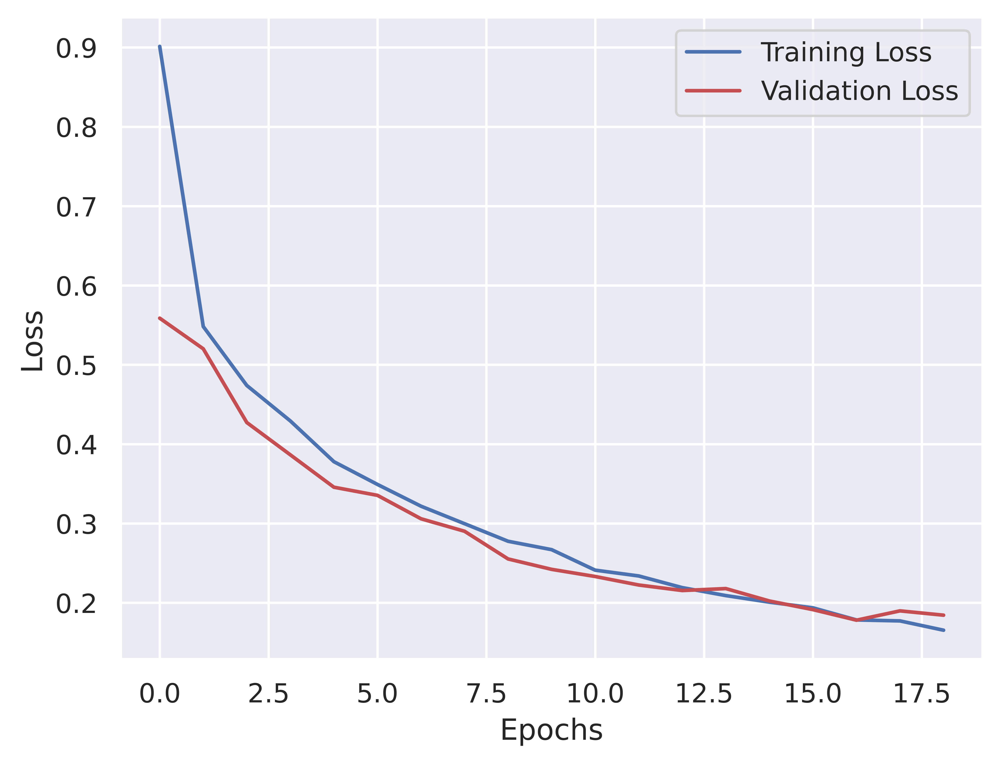

In [ ]:
# Visualize the loss during training
# --------------------------------------------------------------------------------------------------
plt.plot(history.history["loss"], color="b", label="Training Loss")
plt.plot(history.history["val_loss"], color="r", label="Validation Loss")
plt.ylabel("Loss")
plt.xlabel("Epochs")
plt.legend()
plt.show()

In [ ]:
# Create a DataFrame with accuracy and validation accuracy data
# ---------------------------------------------------------------------------------------------------
accuracy_data = pd.DataFrame({
    'Epochs': range(1, len(history.history['accuracy']) + 1),
    'Training Accuracy': history.history['accuracy'],
    'Validation Accuracy': history.history['val_accuracy']})

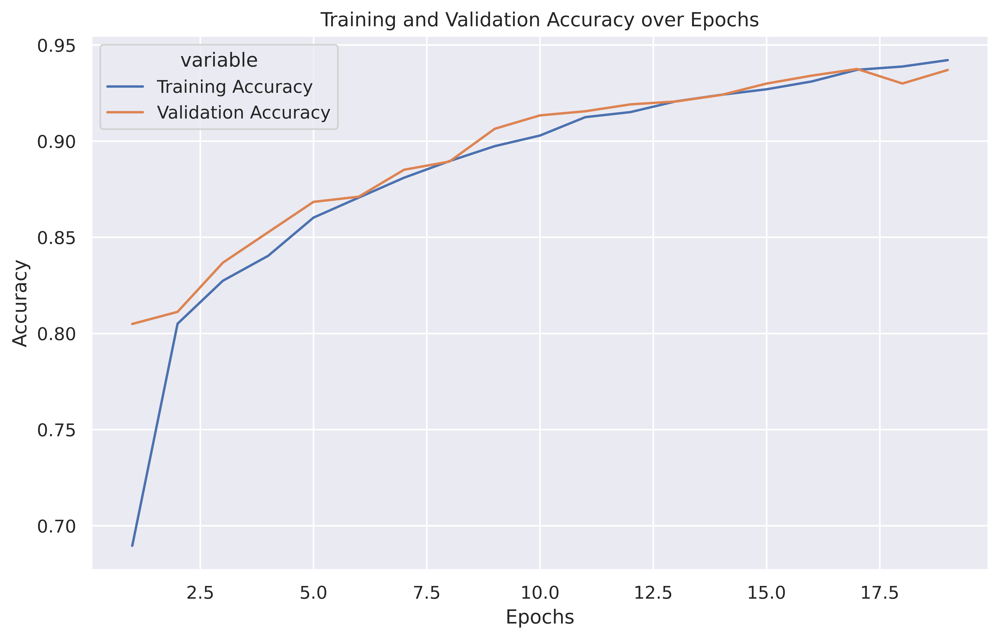

In [ ]:
# Use Seaborn to visualize traing and validation curves
# ---------------------------------------------------------------------------------------------------
plt.figure(figsize=(10, 6))
sns.lineplot(x='Epochs', y='value', hue='variable', data=pd.melt(accuracy_data, ['Epochs']))
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy over Epochs')
plt.show()

671/671 [==============================] - 15s 22ms/step


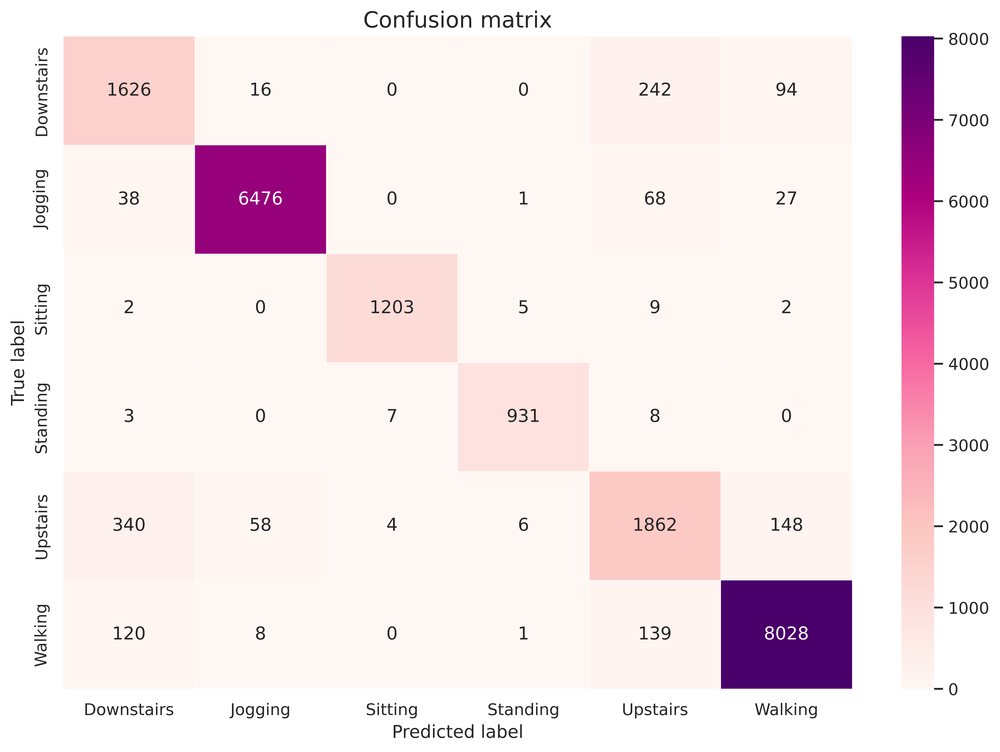

In [ ]:
# Confusion Matrix
# ----------------------------------------------------------------------------------
predictions = model.predict(X_test_m)
LABELS = ['Downstairs', 'Jogging', 'Sitting', 'Standing', 'Upstairs', 'Walking']
max_test = np.argmax(y_test_m, axis=1)
max_predictions = np.argmax(predictions, axis=1)
confusion_matrix = metrics.confusion_matrix(max_test, max_predictions)
plt.figure(figsize=(12, 8))
sns.heatmap(confusion_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True,
            linewidths = 0.1, fmt="d", cmap = 'RdPu');
plt.title("Confusion matrix", fontsize = 15)
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

---

In [ ]:

# f-1 score for each class
f1_scores = f1_score(max_test, max_predictions, average=None)

# f-1 score all class
average_f1_score = f1_score(max_test, max_predictions, average='weighted')

# show
for label, score in zip(LABELS, f1_scores):
    print(f"F1-score for {label}: {score:.4f}")

print(f"\nWeighted F1-score: {average_f1_score:.4f}")

F1-score for Downstairs: 0.7918
F1-score for Jogging: 0.9836
F1-score for Sitting: 0.9881
F1-score for Standing: 0.9836
F1-score for Upstairs: 0.7847
F1-score for Walking: 0.9675

Weighted F1-score: 0.9376


## 🟪 **Logistic Regression**

### 🔹 **Preprocessing** 🔍
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [3]:
# Creation of two dataframes : train and test (users dispastch)
# ----------------------------------------------------------------------------------
# train data -> Users upto User ID = 27 (i.e. 27 users)
df_train = df_acc[df_acc['user'] <= 27]
# test data -> Users from User ID = 28 to 36 (i.e. 9 users)
df_test = df_acc[df_acc['user'] > 27]

#### ▪ **X_TEST preprocessing** 🎛️

In [4]:
# P R E P R O C E S S I N G     X  _  T R A I N
# -----------------------------------------------------------------------------------------------------------------------
# Function to detect peaks in a time series
def detect_peaks(data):
    peaks_indices = find_peaks(data)[0]
    if len(peaks_indices) < 2:
        return np.nan
    time_between_peaks = np.diff(peaks_indices) * 10  #Convert from indices to milliseconds (each index represents 10 ms)
    return np.mean(time_between_peaks)  # Returns average time between peaks

# Lists to store features and labels
x_list = []
y_list = []
z_list = []
train_labels = []
time_between_peaks_x = []
time_between_peaks_y = []
time_between_peaks_z = []

window_size = 100
step_size = 25

# Creation of window-size (200)
for i in range(0, df_train.shape[0] - window_size, step_size):
    xs = df_train['x-axis'].values[i: i + window_size]
    ys = df_train['y-axis'].values[i: i + window_size]
    zs = df_train['z-axis'].values[i: i + window_size]
    label = df_train['activity'][i: i + window_size].value_counts().idxmax()  # Obtener la actividad más común

    # Calculate time between peaks for each axis
    time_between_peaks_x.append(detect_peaks(xs))
    time_between_peaks_y.append(detect_peaks(ys))
    time_between_peaks_z.append(detect_peaks(zs))

    x_list.append(xs)
    y_list.append(ys)
    z_list.append(zs)
    train_labels.append(label)

# Statistical characteristics in the time domain for x, y and z
X_train = pd.DataFrame()

# Average calculation for each axis
X_train['x_mean'] = pd.Series(x_list).apply(lambda x: x.mean())
X_train['y_mean'] = pd.Series(y_list).apply(lambda x: x.mean())
X_train['z_mean'] = pd.Series(z_list).apply(lambda x: x.mean())

# Standard deviation for each axis
X_train['x_std'] = pd.Series(x_list).apply(lambda x: x.std())
X_train['y_std'] = pd.Series(y_list).apply(lambda x: x.std())
X_train['z_std'] = pd.Series(z_list).apply(lambda x: x.std())

# Average absolute difference for each axis
X_train['x_aad'] = pd.Series(x_list).apply(lambda x: np.mean(np.absolute(x - np.mean(x))))
X_train['y_aad'] = pd.Series(y_list).apply(lambda x: np.mean(np.absolute(x - np.mean(x))))
X_train['z_aad'] = pd.Series(z_list).apply(lambda x: np.mean(np.absolute(x - np.mean(x))))

# Calcul of minimum for each axis
X_train['x_min'] = pd.Series(x_list).apply(lambda x: x.min())
X_train['y_min'] = pd.Series(y_list).apply(lambda x: x.min())
X_train['z_min'] = pd.Series(z_list).apply(lambda x: x.min())

# Calcul of maximum for each axis
X_train['x_max'] = pd.Series(x_list).apply(lambda x: x.max())
X_train['y_max'] = pd.Series(y_list).apply(lambda x: x.max())
X_train['z_max'] = pd.Series(z_list).apply(lambda x: x.max())

# Time between peaks for each axis
X_train['time_between_peaks_x'] = time_between_peaks_x
X_train['time_between_peaks_y'] = time_between_peaks_y
X_train['time_between_peaks_z'] = time_between_peaks_z

X_train['most_common_activity'] = train_labels



#### ▪ **X_TEST preprocessing** 🎛️


In [5]:
# P R E P R O C E S S I N G     X  _  T E S T
# -----------------------------------------------------------------------------------------------------------------------
# Function to detect peaks in a time series
def detect_peaks(data):
    peaks_indices = find_peaks(data)[0]
    if len(peaks_indices) < 2:
        return np.nan
    time_between_peaks = np.diff(peaks_indices) * 10  # Convert from indices to milliseconds (each index represents 10 ms)
    return np.mean(time_between_peaks)  # Returns average time between peaks

# Lists to store features and labels
x_list = []
y_list = []
z_list = []
test_labels = []
time_between_peaks_x = []
time_between_peaks_y = []
time_between_peaks_z = []

window_size = 100
step_size = 25

# Creation of window-size (200)
for i in range(0, df_test.shape[0] - window_size, step_size):
    xs = df_test['x-axis'].values[i: i + window_size]
    ys = df_test['y-axis'].values[i: i + window_size]
    zs = df_test['z-axis'].values[i: i + window_size]
    label = df_test['activity'][i: i + window_size].value_counts().idxmax()  # Obtener la actividad más común

    # Calculate time between peaks for each axis
    time_between_peaks_x.append(detect_peaks(xs))
    time_between_peaks_y.append(detect_peaks(ys))
    time_between_peaks_z.append(detect_peaks(zs))

    x_list.append(xs)
    y_list.append(ys)
    z_list.append(zs)
    test_labels.append(label)

# Statistical characteristics in the time domain for x, y and z
X_test = pd.DataFrame()

# Average calculation for each axis
X_test['x_mean'] = pd.Series(x_list).apply(lambda x: x.mean())
X_test['y_mean'] = pd.Series(y_list).apply(lambda x: x.mean())
X_test['z_mean'] = pd.Series(z_list).apply(lambda x: x.mean())

# Standard deviation for each axis
X_test['x_std'] = pd.Series(x_list).apply(lambda x: x.std())
X_test['y_std'] = pd.Series(y_list).apply(lambda x: x.std())
X_test['z_std'] = pd.Series(z_list).apply(lambda x: x.std())

# Average absolute difference for each axis
X_test['x_aad'] = pd.Series(x_list).apply(lambda x: np.mean(np.absolute(x - np.mean(x))))
X_test['y_aad'] = pd.Series(y_list).apply(lambda x: np.mean(np.absolute(x - np.mean(x))))
X_test['z_aad'] = pd.Series(z_list).apply(lambda x: np.mean(np.absolute(x - np.mean(x))))

# Calcul of minimum for each axis
X_test['x_min'] = pd.Series(x_list).apply(lambda x: x.min())
X_test['y_min'] = pd.Series(y_list).apply(lambda x: x.min())
X_test['z_min'] = pd.Series(z_list).apply(lambda x: x.min())

# Calcul of maximum for each axis
X_test['x_max'] = pd.Series(x_list).apply(lambda x: x.max())
X_test['y_max'] = pd.Series(y_list).apply(lambda x: x.max())
X_test['z_max'] = pd.Series(z_list).apply(lambda x: x.max())

# Time between peaks for each axis
X_test['time_between_peaks_x'] = time_between_peaks_x
X_test['time_between_peaks_y'] = time_between_peaks_y
X_test['time_between_peaks_z'] = time_between_peaks_z

X_test['most_common_activity'] = test_labels

# Print the resulting dataframe
print(X_test)


       x_mean  y_mean    z_mean     x_std     y_std     z_std     x_aad  \
0      0.2498  9.3531  2.923335  2.017761  3.286944  2.197032  1.614216   
1      0.5133  9.4588  2.707180  2.114190  3.386510  2.342818  1.673704   
2      0.7676  9.6369  2.594540  1.945526  3.022883  2.282750  1.510688   
3      0.9072  9.6728  2.392278  2.143159  3.436112  2.435438  1.687856   
4      0.6983  9.8614  2.441175  2.466917  4.277981  2.533826  1.960270   
...       ...     ...       ...       ...       ...       ...       ...   
11232 -1.3758  9.4273  2.475771  0.129562  0.083089  0.119516  0.103864   
11233 -1.3576  9.4314  2.460107  0.136427  0.082886  0.119546  0.105728   
11234 -1.3564  9.4370  2.441720  0.132578  0.082250  0.111202  0.101264   
11235 -1.3643  9.4425  2.417339  0.110347  0.074329  0.082726  0.083788   
11236 -1.3413  9.4326  2.454523  0.131557  0.092094  0.080862  0.081890   

          y_aad     z_aad  x_min  y_min     z_min  x_max  y_max     z_max  \
0      2.377610  1.756

#### 🔸**Clarify statistic mesures used** 👋🏼


* **Average** : Average acceleration (for each axis)
  
* **Standard Deviation** : Standard deviation (for each axis)
  
* **Average Absolute Difference** : Average absolute
difference between the value of each of the 200 readings
within the ED and the mean value over those 200 values
(for each axis)
  
* **Average Resultant Acceleration** : Average of the square
roots of the sum of the values of each axis squared
  
* **Time Between Peaks** : Time in milliseconds between
peaks in the sinusoidal waves associated with most
activities (for each axis)


### 🔹 **Train & test sets repartition** ✂️
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [6]:
# Y train and test definition
# ------------------------------------------------------------------------------
y_train = np.array(train_labels)
y_test = np.array(test_labels)

In [7]:
# Remove 'most_common_activity' column from X_train and X_test
# ------------------------------------------------------------------------------
X_train = X_train.drop(columns=['most_common_activity'])
X_test = X_test.drop(columns=['most_common_activity'])

### 🔹 **THE MODEL** 🚀
° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° ° °

In [8]:
# Preprocessing of values before applying the model
# ------------------------------------------------------------------------------
encoder = OneHotEncoder(drop='first')
scaler = StandardScaler()

y_train_encoded = encoder.fit_transform(y_train.reshape(-1, 1))
y_test_encoded = encoder.transform(y_test.reshape(-1, 1))


scaler.fit(X_train)
X_train_data_lr = scaler.transform(X_train)
X_test_data_lr = scaler.transform(X_test)

In [9]:
# Logistic regression
# ------------------------------------------------------------------------------
lr = LogisticRegression(random_state = 21,max_iter=2000)
lr.fit(X_train_data_lr, y_train)
y_pred = lr.predict(X_test_data_lr)
print("Accuracy:", accuracy_score(y_test, y_pred))
print("\n ------------- Classification Report -------------\n")
print(classification_report(y_test, y_pred))
print("\n -------------------------------------------------\n")
f1 = f1_score(y_test, y_pred, average='weighted')
print("F1 Score:", f1)
print("\n -------------------------------------------------\n")

Accuracy: 0.7865088546765151

 ------------- Classification Report -------------

              precision    recall  f1-score   support

  Downstairs       0.62      0.39      0.48      1154
     Jogging       0.81      0.94      0.87      3044
     Sitting       0.89      0.93      0.91       721
    Standing       0.84      0.85      0.84       647
    Upstairs       0.57      0.50      0.53      1276
     Walking       0.83      0.83      0.83      4395

    accuracy                           0.79     11237
   macro avg       0.76      0.74      0.74     11237
weighted avg       0.78      0.79      0.78     11237


 -------------------------------------------------

F1 Score: 0.7765776850083845

 -------------------------------------------------



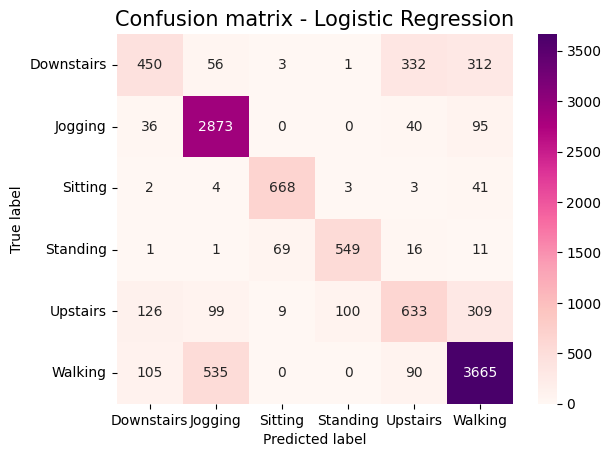

In [10]:
# Confusion Matrix

from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, f1_score

conf_matrix = confusion_matrix(y_test, y_pred)

labels = np.unique(y_test)

sns.heatmap(conf_matrix, xticklabels=labels, yticklabels=labels, annot=True, fmt="d", cmap='RdPu')


plt.title("Confusion matrix - Logistic Regression", fontsize=15)
plt.ylabel('True label')
plt.xlabel('Predicted label')

plt.show()

----

## 🟥 **AdaBoost Classifier with Logistic Regression** (ENSEMBLE technic)

In [11]:
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import GridSearchCV

print("Grid search...")
print()
logistic_regression = LogisticRegression(max_iter = 1000)
adaboost_logreg = AdaBoostClassifier(logistic_regression)

# Grid of values to be tested
adaboost_logreg_params = {
    'base_estimator__C': [0.01, 0.05, 0.1, 0.5, 1.0, 5.0, 10.0, 50.0],
    'n_estimators': [5, 10, 20, 40, 60, 80, 100]
}

gridsearch = GridSearchCV(adaboost_logreg, param_grid = adaboost_logreg_params, cv = 3)
gridsearch.fit(X_train_data_lr, y_train)
print("...Done.")

print()
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)
print()

GS_Y_test_pred = gridsearch.predict(X_test_data_lr)
print('Predictions on the test set : ', GS_Y_test_pred)


print("\n ------------- Classification Report -------------\n")
print(classification_report(y_test, GS_Y_test_pred))
print("\n -------------------------------------------------\n")


Grid search...

...Done.

Best hyperparameters :  {'base_estimator__C': 5.0, 'n_estimators': 5}
Best validation accuracy :  0.7227216807040787

Predictions on the test set :  ['Upstairs' 'Upstairs' 'Walking' ... 'Standing' 'Standing' 'Standing']

 ------------- Classification Report -------------

              precision    recall  f1-score   support

  Downstairs       0.73      0.22      0.34      1154
     Jogging       0.82      0.92      0.87      3044
     Sitting       0.99      0.90      0.94       721
    Standing       0.92      0.93      0.92       647
    Upstairs       0.53      0.32      0.40      1276
     Walking       0.71      0.87      0.78      4395

    accuracy                           0.76     11237
   macro avg       0.78      0.69      0.71     11237
weighted avg       0.75      0.76      0.73     11237


 -------------------------------------------------



---

# 👋🏼 **CONCLUSIONS** ✅

The LSTM-CNN model performs significantly better than the Linear Regression Model.

- LSTM:
  It achieves an overall F1 score of approximately 0.94.

  Additionally, we can observe from the confusion matrix that the model finds it more challenging to detect whether the user is ascending or descending stairs.

- Linear Regression:
  This model requires much more significant feature engineering compared to the LSTM model and does not achieve as good results.

  In this section, we can also observe how AdaBoost did not improve; in fact, it slightly decreased the performance of the model. One of the reasons for this could be that if the base model performs poorly or makes systematic errors in certain areas of the feature space, the AdaBoost algorithm may incorrectly emphasize these errors and worsen the overall performance of the model


---

*CREATED BY EUGENIA MELLANO & DORIANE DOYON-DOUSSE*